In [1]:
import os
import cmath
import librosa
import soundfile as sf
import matplotlib.pyplot as plt
import numpy as np
import sklearn.decomposition as skd

try:
    from jupyterthemes import jtplot
    jtplot.style()
except ImportError:
    pass

def soundsc( s, r=16000, name=''):
    from IPython.display import display, Audio, HTML
    if name is '':
        display( Audio( s, rate=r))
    else:
        display( HTML( 
        '<style> table, th, td {border: 0px; }</style> <table><tr><td>' + name + 
        '</td><td>' + Audio( s, rate=r)._repr_html_()[3:] + '</td></tr></table>'
        ))

In [2]:
def stft(samples, n_fft=4096, hop_length=256, window="hann"):
    # samples is a numpy array of shape (num_samples, )
    spectra = librosa.core.stft(samples, n_fft=n_fft, hop_length=hop_length, window=window)
    return spectra

def istft(stft, win_length=4096, hop_length=256, window="hann"):
    # stft is of shape (stft_size//2+1, num_stft_frames)
    return librosa.core.istft(stft, win_length=win_length, hop_length=hop_length, window=window)

In [3]:
def load_dsd(dsd_path):
    num_sources = 4
    n_fft = 4096
    features = n_fft//2 + 1
    mixtures_train = np.zeros((features, 1))
    mixtures_test = np.zeros((features, 1))

    sources_train = [np.zeros((features, 1))]*num_sources
    sources_test = [np.zeros((features, 1))]*num_sources

    for track_dir in os.listdir(os.path.join(dsd_path, "Mixtures", "Dev")):
        samples, sr = librosa.load(os.path.join(dsd_path, "Mixtures", "Dev", track_dir, "mixture.wav"), sr=None)
        spectra = np.abs(stft(samples, n_fft=n_fft))
        mixtures_train = np.hstack((mixtures_train, spectra))

    for track_dir in os.listdir(os.path.join(dsd_path, "Mixtures", "Test")):
        samples, sr = librosa.load(os.path.join(dsd_path, "Mixtures", "Test", track_dir, "mixture.wav"), sr=None)
        spectra = np.abs(stft(samples, n_fft=n_fft))
        mixtures_test = np.hstack((mixtures_test, spectra))

    for track_dir in os.listdir(os.path.join(dsd_path, "Sources", "Dev")):
        for i, source in enumerate(sorted(os.listdir(os.path.join(dsd_path, "Sources", "Dev", track_dir)))):
            samples, sr = librosa.load(os.path.join(dsd_path, "Sources", "Dev", track_dir, source), sr=None)
            spectra = np.abs(stft(samples, n_fft=n_fft))
            sources_train[i] = np.hstack((sources_train[i], spectra))

    for track_dir in os.listdir(os.path.join(dsd_path, "Sources", "Test")):
        for i, source in enumerate(sorted(os.listdir(os.path.join(dsd_path, "Sources", "Test", track_dir)))):
            samples, sr = librosa.load(os.path.join(dsd_path, "Sources", "Test", track_dir, source), sr=None)
            spectra = np.abs(stft(samples, n_fft=n_fft))
            sources_test[i] = np.hstack((sources_test[i], spectra))


    mixtures_train = mixtures_train[:, 1:]
    mixtures_test = mixtures_test[:, 1:]
    print(mixtures_train.shape)
    print(mixtures_test.shape)

    sources_train = np.dstack([el[:, 1:] for el in sources_train])
    sources_test = np.dstack([el[:, 1:] for el in sources_test])
    print(sources_train.shape)
    print(sources_test.shape)
    
    return mixtures_train, mixtures_test, sources_train, sources_test
    
    
dsd_path = "DSD100subset"
mixtures_train, mixtures_test, sources_train, sources_test = load_dsd(dsd_path)

(2049, 14831)
(2049, 14889)
(2049, 14831, 4)
(2049, 14889, 4)


In [4]:
W_sources = []
num_spectra = 40
for source_num in range(sources_train.shape[-1]):
    print(source_num)
    model = skd.NMF(n_components=num_spectra, init='random', random_state=0, max_iter=5000)
    W = model.fit_transform(sources_train[:, :, source_num])
    H = model.components_
    W_sources.append(W)

0
1
2
3


In [11]:
# %matplotlib inline
def show_W(W):
    fig, ax = plt.subplots(1, W.shape[1])
    for i in range(W.shape[1]):
        ax[i].plot(W[:, i], np.arange(W.shape[0]))
        ax[i].set_axis_off()
for W in W_sources:
    show_W(W)

In [6]:
# F = [W1 W2 W3 W4][H1 \ H2 \ H3 \ H4]
W_mix = np.hstack(W_sources)
H_mix = np.random.rand(num_spectra*num_sources, sources_test.shape[1])
print(W_mix.shape, H_mix.shape)

(513, 160) (160, 14889)


In [9]:
def nmf_fixW(X, W, H):
    
    iterations = 1000
    eps = 1e-9
    errors = []
    
    import tqdm
    pbar = tqdm.tqdm_notebook(total=iterations)
    for it in range(iterations):
        prev_H = H.copy()
        
        WH = np.matmul(W, H)      
        # Update H
        num = W.T@(X/(WH+eps))
        den = np.sum(W, axis=0)
        upd = (num.T/(den+eps)).T
        H = H*upd
        
        H /= np.linalg.norm(H)
        
        error = np.linalg.norm(H-prev_H, ord='fro')
        errors.append(error)
        pbar.set_description(str(error))
        pbar.update(1)
        if error < 1e-3:
            break
        if it == iterations-1:
            print(f"NMF did not converge")
            fig, ax = plt.subplots()
            ax.plot(errors[2:])
    return {'H':H, 'W': W, 'errors':errors}

In [8]:
X = np.abs(mixtures_test)
phase = np.angle(mixtures_test)
nmf_res = nmf_fix(X, W_mix, H_mix)

/home/pranav/.local/lib/python3.6/site-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


In [11]:
H_mix = nmf_res['H']
print(H_mix.min())
H_sources = [H_mix[i:i+num_spectra, :] for i in range(0, num_sources*num_spectra, num_spectra)]
print([el.shape for el in H_sources])
print([el.shape for el in W_sources])

0.0
[(40, 14889), (40, 14889), (40, 14889), (40, 14889)]
[(513, 40), (513, 40), (513, 40), (513, 40)]


In [12]:
reconstructed = [w@h for w, h in zip(W_sources, H_sources)]

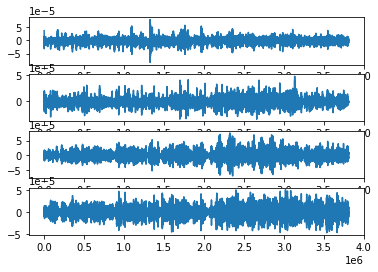

In [13]:
%matplotlib inline
fig, ax = plt.subplots(len(reconstructed), 1)
for i, source in enumerate(reconstructed):
    source = np.vectorize(cmath.rect)(source, phase)
    samples = istft(source)
    ax[i].plot(samples)
    soundsc(samples)
#     soundsc(istft(sources_test[i]))
    sf.write(f'source_{i}.wav', samples, sr)
#     break

In [18]:
print(sources_train[:, :, 0].real.shape)

(513, 14831)


In [4]:
#Toy example
sources = []
samples, sr = librosa.load("voice", sr=None)
voice_samples_test = samples[:int(3.5*sr)]
voice_samples_train = samples[int(3.5*sr):]
sources.append(np.abs(stft(voice_samples_train, n_fft=4096, window="hann", hop_length=256)))

samples, sr = librosa.load("chimes", sr=None)
chimes_samples_test = samples[:int(3.5*sr)]
chimes_samples_train = samples[int(3.5*sr):]
sources.append(np.abs(stft(chimes_samples_train, n_fft=4096, window="hann", hop_length=256)))

W_sources = []
for source_num in range(len(sources)):
    print(source_num)
    model = skd.NMF(n_components=40, init='random', random_state=0, max_iter=5000)
    W = model.fit_transform(sources[source_num])
    W_sources.append(W)



0
1


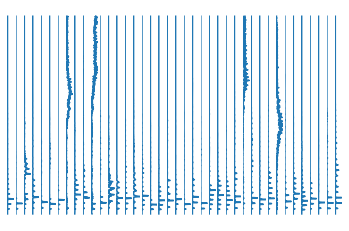

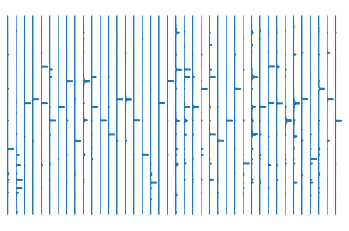

In [7]:
for W in W_sources:
    show_W(W)

(56000,)
(2049, 219)
(2049, 80) (80, 219)


/home/pranav/.local/lib/python3.6/site-packages/ipykernel_launcher.py:8: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


1.3200953522501323e-30



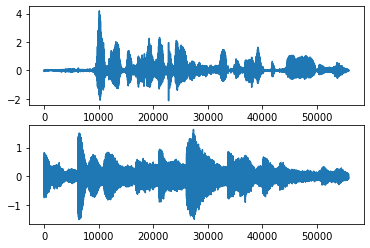

In [10]:
samples = voice_samples_test + chimes_samples_test
soundsc(samples)
print(samples.shape)
X = stft(samples, n_fft=4096, window="hann", hop_length=256)
phase = np.angle(X)
X = np.abs(X)
print(X.shape)

# m = np.mean(X, axis=1)
# X = X - m[:, np.newaxis]

W_mix = np.hstack(W_sources)
H_mix = np.random.rand(2*40, X.shape[1])
print(W_mix.shape, H_mix.shape)
H_mix = nmf_fixW(X, W_mix, H_mix)['H']

print(H_mix.min())
H_sources = [H_mix[i:i+40, :] for i in range(0, 2*40, 40)]

reconstructed = [w@h for w, h in zip(W_sources, H_sources)]

fig, ax = plt.subplots(len(reconstructed), 1)
for i, source in enumerate(reconstructed):
    source = np.vectorize(cmath.rect)(source, phase)
    samples = istft(source)*500
    ax[i].plot(samples)
    soundsc(samples)
#     ax[0].imshow(source, aspect='auto')
#     ax[0].imshow(sources_train[:, :, i].real, aspect='auto')
#     ax[1].imshow(sources_train[:, :, i].imag, aspect='auto')
#     ax[2].imshow(np.log(np.abs(sources_train[:, :, i])), aspect='auto')
#     sf.write(f'source_{i}.wav', samples, sr)
#     break